In [1]:
from nemo.collections.tts.models import MagpieTTSModel
from nemo.collections.tts.data.text_to_speech_dataset import MagpieTTSDataset, DatasetSample
from omegaconf.omegaconf import OmegaConf, open_dict
import torch
import os
import soundfile as sf
from IPython.display import display, Audio
import numpy as np
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="0"
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "expandable_segments:True"
torch.cuda.empty_cache()
torch.cuda.ipc_collect()

[NeMo W 2026-01-07 01:57:24 nemo_logging:364] /usr/local/lib/python3.12/dist-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
      from .autonotebook import tqdm as notebook_tqdm
    


### Checkpoint Paths

In [5]:
hparams_file ="/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_add_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd300_vbd300_precision32_0/hprams_hi_char.yaml"
#"/lustre/fsw/portfolios/edgeai/users/quapham/magpie_2508/data_cfg/hprams_hi_ipa.yaml"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_add_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd300_vbd300_precision32_0/hprams_hi_char.yaml"

#
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_add_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd300_vbd300_precision32_0/hprams_hi_char.yaml"
#"/lustre/fsw/portfolios/edgeai/users/quapham/magpie_2508/data_cfg/hprams_hi_ipa.yaml"
#"/lustre/fsw/portfolios/edgeai/users/quapham/magpie_2508/data_cfg/hprams_hi_char.yaml"

checkpoint_file="/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/GRPO_AlignedManifests_11_3_2025_casual/Uniform__9_7497_step_693030_MagpieMultilingual_GRPO_2508/grpo_en_es_de_fr_vi_hi_ja/Magpie-TTS-ML-V1--val_cer_gt=0.3496-step=1050.ckpt"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_v1_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_ipa_lr2e-4_tbd300_vbd300_precision32_0/magpieTTS/0/checkpoints/Magpie-TTS-ML--val_loss=9.7969-step=401967-last.ckpt"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/GRPO_AlignedManifests_11_3_2025_casual/Uniform__9_7497_step_693030_MagpieMultilingual_GRPO_2508/grpo_en_es_de_fr_vi_hi_ja/Magpie-TTS-ML-V1--val_cer_gt=0.3496-step=1050.ckpt"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_v1_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd300_vbd300_precision32_0/Magpie-TTS-ML--val_loss=9.7612-step=651028.ckpt"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_add_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd300_vbd300_precision32_0/magpieTTS/0/checkpoints/Magpie-TTS-ML--val_loss=9.8104-step=322013.ckpt"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_add_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_ipa_lr2e-4_tbd300_vbd300_precision32_0/magpieTTS/0/checkpoints/Magpie-TTS-ML--val_loss=9.8657-step=196008.ckpt"
#"/checkpoints/experiments/Lothse_magpieTTS_feb_multi_reduce_vi_add_davidAI_hi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd300_vbd300_precision32_0/magpieTTS/0/checkpoints/Magpie-TTS-ML--val_loss=9.8689-step=196008.ckpt"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd350_vbd300_precision32_0/magpieTTS/0/checkpoints/Magpie-TTS-ML--val_loss=9.7806-step=490025.ckpt"

#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi/DCCE_NC21FPS_8cb_multi_hi_ipa_lr2e-4_tbd350_vbd300_precision32_0/magpieTTS/0/checkpoints/Magpie-TTS-ML--val_loss=9.9097-step=147010.ckpt"
#"/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi/DCCE_NC21FPS_8cb_multi_hi_char_lr2e-4_tbd350_vbd300_precision32_0/magpieTTS/0/checkpoints/Magpie-TTS-ML--val_loss=9.8315-step=259014.ckpt"

codecmodel_path = "/gitrepos/checkpoints/21fps_causal_codecmodel.nemo"

out_dir = "/output/infer_notebooks/"
if not os.path.exists(out_dir):
    os.makedirs(out_dir)

### Load Model

In [3]:
model_cfg = OmegaConf.load(hparams_file).cfg

with open_dict(model_cfg):
    model_cfg.codecmodel_path = codecmodel_path
    if hasattr(model_cfg, 'text_tokenizer'):
        # Backward compatibility for models trained with absolute paths in text_tokenizer
        model_cfg.text_tokenizer.g2p.phoneme_dict = "scripts/tts_dataset_files/ipa_cmudict-0.7b_nv23.01.txt"
        model_cfg.text_tokenizer.g2p.heteronyms = "scripts/tts_dataset_files/heteronyms-052722"
        model_cfg.text_tokenizer.g2p.phoneme_probability = 1.0
    model_cfg.train_ds = None
    model_cfg.validation_ds = None


model = MagpieTTSModel(cfg=model_cfg)
ckpt = torch.load(checkpoint_file, weights_only=False)
model.load_state_dict(ckpt['state_dict'])

model.use_kv_cache_for_inference = True

model.cuda()
model.eval()

[NeMo W 2026-01-07 01:57:54 modelPT:181] If you intend to do training or fine-tuning, please call the ModelPT.setup_training_data() method and provide a valid configuration file to setup the train data loader.
    Train config : 
    dataset:
      dataset_type: tarred_vocoder
      dataset_args:
        dataset_meta:
          mls_english:
            manifest_path: /lustre/fsw/portfolios/llmservice/projects/llmservice_nemo_speechlm/data/TTS/mls_english/filtered_22khz/tarred_audio/train_manifest.json
            tar_filepath: /lustre/fsw/portfolios/llmservice/projects/llmservice_nemo_speechlm/data/TTS/mls_english/filtered_22khz/tarred_audio/audio_{0..1999}.tar
          cv:
            manifest_path: /lustre/fsw/portfolios/llmservice/projects/llmservice_nemo_speechlm/data/TTS/commonvoice13/22khz/tarred_audio/train_manifest.json
            tar_filepath: /lustre/fsw/portfolios/llmservice/projects/llmservice_nemo_speechlm/data/TTS/commonvoice13/22khz/tarred_audio/audio_{0..279}.tar
    

[NeMo I 2026-01-07 01:57:54 audio_codec:101] Vector quantizer does not support commit loss.
[NeMo I 2026-01-07 01:57:55 features:306] PADDING: 1
[NeMo I 2026-01-07 01:57:55 features:306] PADDING: 1
[NeMo I 2026-01-07 01:57:55 features:306] PADDING: 1
[NeMo I 2026-01-07 01:57:55 features:306] PADDING: 1
[NeMo I 2026-01-07 01:57:55 features:306] PADDING: 1
[NeMo I 2026-01-07 01:57:55 features:306] PADDING: 1
[NeMo I 2026-01-07 01:57:56 save_restore_connector:282] Model AudioCodecModel was successfully restored from /gitrepos/checkpoints/21fps_causal_codecmodel.nemo.


[NeMo W 2026-01-07 01:57:56 experimental:26] `<class 'nemo.collections.tts.g2p.models.i18n_ipa.IpaG2p'>` is experimental and not ready for production yet. Use at your own risk.
[NeMo W 2026-01-07 01:57:57 i18n_ipa:125] apply_to_oov_word=None, This means that some of words will remain unchanged if they are not handled by any of the rules in self.parse_one_word(). This may be intended if phonemes and chars are both valid inputs, otherwise, you may see unexpected deletions in your input.
[NeMo W 2026-01-07 01:57:57 experimental:26] `<class 'nemo.collections.common.tokenizers.text_to_speech.tts_tokenizers.IPATokenizer'>` is experimental and not ready for production yet. Use at your own risk.
[NeMo W 2026-01-07 01:57:57 experimental:26] `<class 'nemo.collections.tts.g2p.models.i18n_ipa.IpaG2p'>` is experimental and not ready for production yet. Use at your own risk.
[NeMo W 2026-01-07 01:57:58 i18n_ipa:125] apply_to_oov_word=None, This means that some of words will remain unchanged if they 

[NeMo I 2026-01-07 01:58:04 magpietts:274] Local transformer type: autoregressive


RuntimeError: Error(s) in loading state_dict for Embedding:
	size mismatch for weight: copying a param with shape torch.Size([2322, 768]) from checkpoint, the shape in current model is torch.Size([2323, 768]).

In [4]:
# Đọc config từ wandb run
import yaml

with open("/lustre/fsw/portfolios/edgeai/users/quapham/checkpoints/experiments/Lothse_magpieTTS_feb_multi/DCCE_NC21FPS_8cb_multi_hi_ipa_lr2e-4_tbd350_vbd300_precision32_0/wandb/latest-run/files/config.yaml") as f:
    ckpt_config = yaml.safe_load(f)

# So sánh tokenizers
ckpt_tokenizers = ckpt_config.get('model', {}).get('text_tokenizers', {})
for name in ckpt_tokenizers:
    print(f"Checkpoint has: {name}")

### Initialize Dataset class and helper functions

In [9]:
test_dataset = MagpieTTSDataset(
    dataset_meta={},
    sample_rate=model.sample_rate,
    min_duration=0.5,
    max_duration=20,
    codec_model_samples_per_frame=model.codec_model_samples_per_frame,
    bos_id=model.bos_id,
    eos_id=model.eos_id,
    context_audio_bos_id=model.context_audio_bos_id,
    context_audio_eos_id=model.context_audio_eos_id,
    audio_bos_id=model.audio_bos_id,
    audio_eos_id=model.audio_eos_id,
    num_audio_codebooks=model.num_audio_codebooks,
    prior_scaling_factor=None,
    load_cached_codes_if_available=False,
    dataset_type='test',
    tokenizer_config=None,
    load_16khz_audio=model.model_type == 'decoder_ce',
    use_text_conditioning_tokenizer=model.use_text_conditioning_encoder,
    text_conditioning_tokenizer_name=model.text_conditioning_tokenizer_name,  # ✅ ADD THIS!
    pad_context_text_to_max_duration=model.pad_context_text_to_max_duration,
    context_duration_min=model.cfg.get('context_duration_min', 5.0),
    context_duration_max=model.cfg.get('context_duration_max', 5.0),  # ✅ Fix this too (was 'min')
)
#test_dataset.text_tokenizer, test_dataset.text_conditioning_tokenizer = model.setup_tokenizers(model.cfg, mode='test')
test_dataset.text_tokenizer = model.tokenizer

def get_audio_duration(file_path):
    with sf.SoundFile(file_path) as audio_file:
        # Calculate the duration
        duration = len(audio_file) / audio_file.samplerate
        return duration

def create_record(text, context_audio_filepath=None, context_text=None):
    dummy_audio_fp = os.path.join(out_dir, "dummy_audio.wav")
    dummy_audio = sf.write(dummy_audio_fp, np.zeros(22050 * 3), 22050)  # 3 seconds of silence
    record = {
        'audio_filepath' : dummy_audio_fp,
        'duration': 3.0,
        'text': text,
        'speaker': "dummy",
    }
    if context_text is not None:
        assert context_audio_filepath is None
        record['context_text'] = context_text
    else:
        assert context_audio_filepath is not None
        record['context_audio_filepath'] = context_audio_filepath
        record['context_audio_duration'] = get_audio_duration(context_audio_filepath)
    
    return record

### Set transcript and context pairs to test

In [13]:
import pprint
# Change sample text and prompt audio/text here
audio_base_dir = "/"
test_entries = [
    create_record(
         text="जी मैं एस पी बैंक से मैनेजर विकास धाकड़ बात कर रहा हूँ बताइए आपकी किस प्रकार सहायता कर सकता हूँ..",
        #"जी मैं एस पी बैंक से मैनेजर विकास धाकड़ बात कर रहा हूँ बताइए आपकी किस प्रकार सहायता कर सकता हूँ.",
        #"ファストネムでお呼びすることをお許し下さい。",
         #"जी मैं एस पी बैंक से मैनेजर विकास धाकड़ बात कर रहा हूँ बताइए आपकी किस प्रकार सहायता कर सकता हूँ.",
         #"पुलिस इस बीच सत्यम की तलाश में लगातार छापेमारी कर रही थी.",
         context_text="Speaker and Emotion: | Language:vi Dataset:riva Speaker:Phung_Neutral |",
#        context_audio_filepath="/datap/misc/LibriTTSfromNemo/LibriTTS/test-clean/7729/102255/7729_102255_000012_000001.wav", # Supply either context_audio_filepath or context_text, not both
    ),
#         create_record(
#          text="पुलिस इस बीच सत्यम की तलाश में लगातार छापेमारी कर रही थी.",
#          context_text="Speaker and Emotion: | Language:vi Dataset:Riva Speaker:Long_Happy |",
# #        context_audio_filepath="/datap/misc/LibriTTSfromNemo/LibriTTS/test-clean/7729/102255/7729_102255_000012_000001.wav", # Supply either context_audio_filepath or context_text, not both
#     ),
]

data_samples = []
for entry in test_entries:
    dataset_sample = DatasetSample(
        dataset_name="sample",
        manifest_entry=entry,
        audio_dir=audio_base_dir,
        feature_dir=audio_base_dir,
        text=entry['text'],
        speaker=None,
        speaker_index=0,
        tokenizer_names=["hindi_phoneme"], # Change this for multilingual: "english_phoneme", "spanish_phoneme", "english_chartokenizer", "german_chartokenizer".. 
    )
    data_samples.append(dataset_sample)
    
test_dataset.data_samples = data_samples

test_data_loader = torch.utils.data.DataLoader(
    test_dataset,
    batch_size=1,
    collate_fn=test_dataset.collate_fn,
    num_workers=0,
    shuffle=False
)

### Generate With Prior

Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
Decoding timestep 80
Decoding timestep 100
Decoding timestep 120
Decoding timestep 140
End detected for item 0 at decoder timestep: 143
All ends reached
जी मैं एस पी बैंक से मैनेजर विकास धाकड़ बात कर रहा हूँ बताइए आपकी किस प्रकार सहायता कर सकता हूँ..
Prior Used? True
Prior Used? True


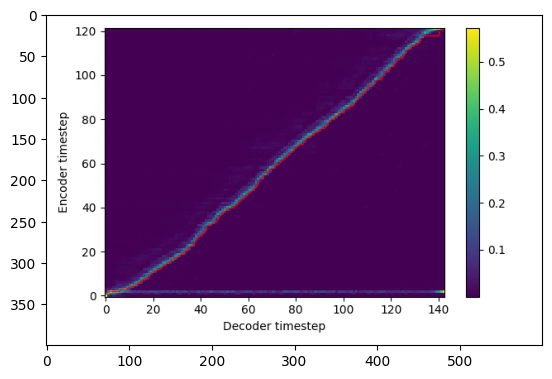

item, layer, head 0 0 0


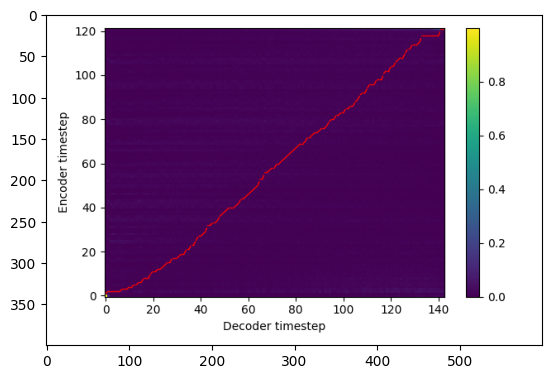

item, layer, head 0 1 0


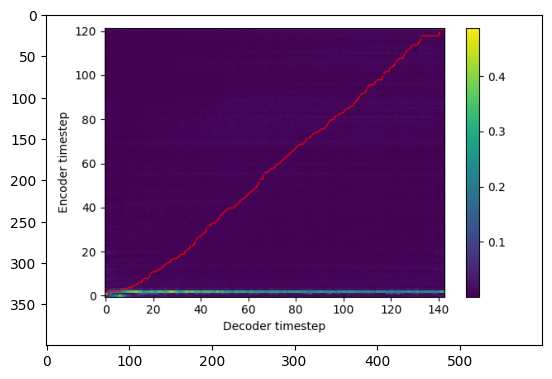

item, layer, head 0 2 0


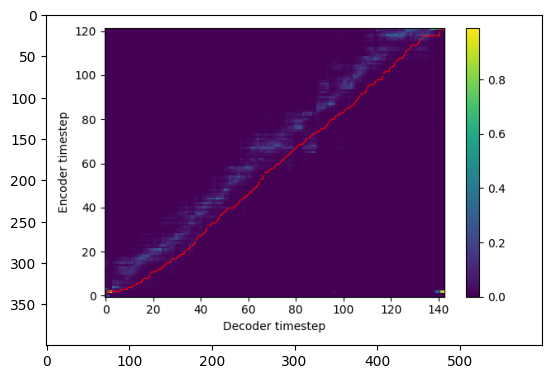

item, layer, head 0 3 0


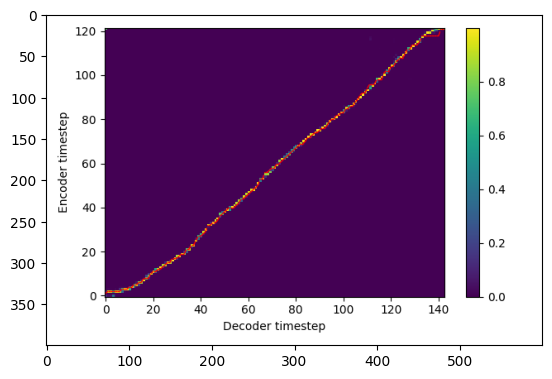

item, layer, head 0 4 0


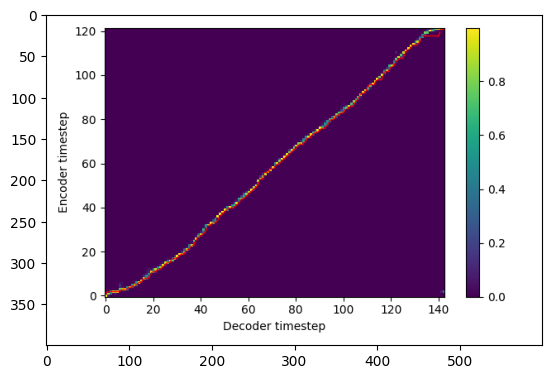

item, layer, head 0 5 0


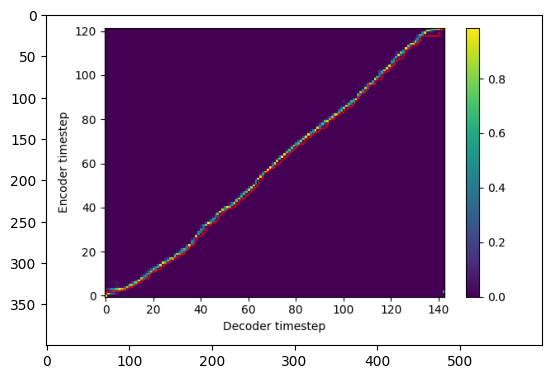

item, layer, head 0 6 0


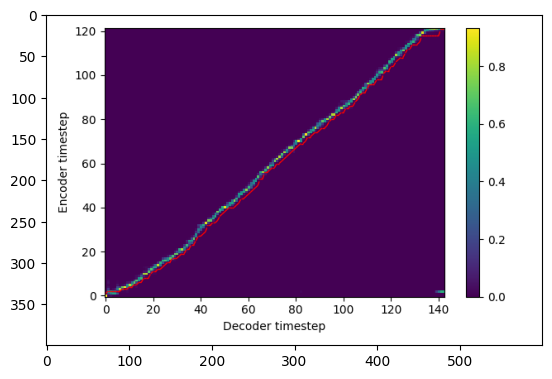

item, layer, head 0 7 0


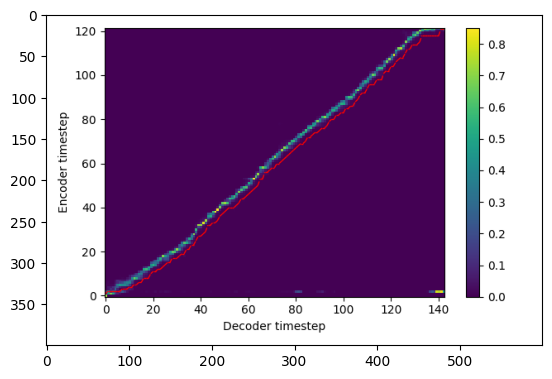

item, layer, head 0 8 0


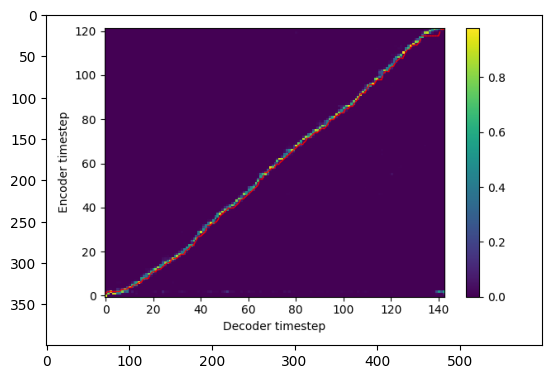

item, layer, head 0 9 0


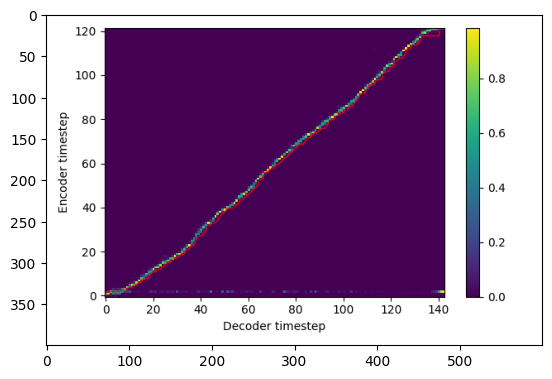

item, layer, head 0 10 0


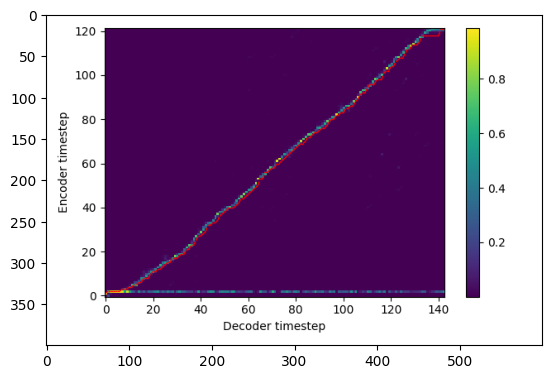

item, layer, head 0 11 0


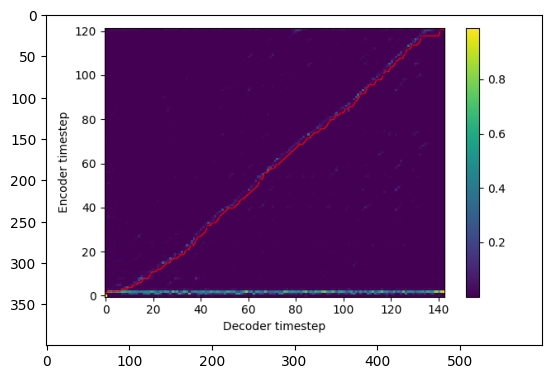

------------------------------------
------------------------------------


In [14]:
import matplotlib.pyplot as plt
#model.use_text_conditioning_encoder = True
item_idx = 0
for bidx, batch in enumerate(test_data_loader):
  
    #print("Processing batch {} out of {}".format(bidx, len(test_data_loader)))
    model.decoder.reset_cache(use_cache=True)
    batch_cuda ={}
    for key in batch:
        if isinstance(batch[key], torch.Tensor):
            batch_cuda[key] = batch[key].cuda()
        else:
            batch_cuda[key] = batch[key]
    import time
    st = time.time()

    for apply_prior in [True]:
        predicted_audio, predicted_audio_lens, _, _, all_heads_attn_np, cross_attn_np, xall_heads = model.infer_batch(
            batch_cuda, 
            max_decoder_steps=440, 
            temperature=0.6, 
            topk=80, 
            use_cfg=True,
            cfg_scale=2.5,
            prior_epsilon=0.1,
            lookahead_window_size=5,
            return_cross_attn_probs=True,
            estimate_alignment_from_layers=[3,4,5,6],
            apply_attention_prior=apply_prior,
            apply_prior_to_layers=[3,4,5,6,7,8,9,10],
            compute_all_heads_attn_maps=True,
            use_local_transformer_for_inference=True,
            maskgit_n_steps=3,
            start_prior_after_n_audio_steps=0
        )
        #print("generation time", time.time() - st)
        for idx in range(predicted_audio.size(0)):
            predicted_audio_np = predicted_audio[idx].float().detach().cpu().numpy()
            predicted_audio_np = predicted_audio_np[:predicted_audio_lens[idx]]
            audio_path = os.path.join(out_dir, f"predicted_audio_{item_idx}.wav")
            sf.write(audio_path, predicted_audio_np, 22050)
            print(test_entries[bidx]['text'])
            print("Prior Used?", apply_prior)
            print("Prior Used?", apply_prior)
            #print("use_local_transformer", use_local_transformer_for_inference)
            display(Audio(audio_path))
            item_idx += 1
            plt.imshow(cross_attn_np[idx])
            plt.show()
            print_all_layers = True
            if print_all_layers==True:
                for hidx, head_cross_attn in enumerate(xall_heads[idx]):
                    layer_num = hidx // model.cfg.decoder.xa_n_heads
                    head_num = hidx % model.cfg.decoder.xa_n_heads
                    print("item, layer, head", idx, layer_num, head_num)
                    plt.imshow(xall_heads[idx][hidx])
                    plt.show()
                
        print("------------------------------------")
        print("------------------------------------")
#Suīrán xuéxí yì mén xīn de yǔyán fēicháng yǒu tiǎozhànxìng, dànshì rúguǒ měitiān jiānchí liànxí, bùduàn jīlěi cíhuì hé yǔfǎ zhīshì,

In [46]:
from nemo.collections.common.tokenizers.text_to_speech.tts_tokenizers import IPATokenizer
from nemo.collections.tts.g2p.models.i18n_ipa import IpaG2p

g2p = IpaG2p(
    phoneme_dict="scripts/tts_dataset_files/hi_IN/hi_prondictt-v0.1.dict",
    locale="hi-IN",
    phoneme_probability=0.8,
    use_chars=True,
    use_stresses=False,
    grapheme_case="mixed",
    grapheme_prefix=""  # prefix '#'
)

tokenizer = IPATokenizer(
    locale="hi-IN",
    punct=True,
    apostrophe=True,
    pad_with_space=True,
    g2p=g2p
)

print(f"Hindi IPA Tokenizer vocab size: {len(tokenizer.tokens)}")
print(f"tokens: {tokenizer.tokens}")

[NeMo W 2026-01-07 00:48:25 experimental:26] `<class 'nemo.collections.tts.g2p.models.i18n_ipa.IpaG2p'>` is experimental and not ready for production yet. Use at your own risk.
[NeMo W 2026-01-07 00:48:26 i18n_ipa:125] apply_to_oov_word=None, This means that some of words will remain unchanged if they are not handled by any of the rules in self.parse_one_word(). This may be intended if phonemes and chars are both valid inputs, otherwise, you may see unexpected deletions in your input.
[NeMo W 2026-01-07 00:48:26 experimental:26] `<class 'nemo.collections.common.tokenizers.text_to_speech.tts_tokenizers.IPATokenizer'>` is experimental and not ready for production yet. Use at your own risk.


Hindi IPA Tokenizer vocab size: 150
tokens: ['!', '"', "'", '(', ')', ',', '-', '.', '/', ':', ';', '?', '[', ']', 'a', 'b', 'c', 'd', 'e', 'f', 'h', 'i', 'j', 'k', 'l', 'm', 'n', 'o', 'p', 'q', 'r', 's', 't', 'u', 'w', 'x', 'z', '{', '}', 'ã', 'õ', 'ĩ', 'ŋ', 'ũ', 'ɔ', 'ɖ', 'ə', 'ɛ', 'ɟ', 'ɡ', 'ɣ', 'ɪ', 'ɭ', 'ɲ', 'ɳ', 'ɾ', 'ʂ', 'ʃ', 'ʈ', 'ʊ', 'ʋ', 'ʌ', 'ʰ', 'ː', '̃', '̩', 'χ', 'ँ', 'ं', 'ः', 'अ', 'आ', 'इ', 'ई', 'उ', 'ऊ', 'ऋ', 'ऌ', 'ऍ', 'ऎ', 'ए', 'ऐ', 'ऑ', 'ओ', 'औ', 'क', 'ख', 'ग', 'घ', 'ङ', 'च', 'छ', 'ज', 'झ', 'ञ', 'ट', 'ठ', 'ड', 'ढ', 'ण', 'त', 'थ', 'द', 'ध', 'न', 'ऩ', 'प', 'फ', 'ब', 'भ', 'म', 'य', 'र', 'ऱ', 'ल', 'ळ', 'ऴ', 'व', 'श', 'ष', 'स', 'ह', 'ऺ', '़', 'ऽ', 'ा', 'ि', 'ी', 'ु', 'ू', 'ृ', 'ॅ', 'ॆ', 'े', 'ै', 'ॉ', 'ॊ', 'ो', 'ौ', '्', 'ॐ', '॓', 'ॠ', 'ॡ', 'ॢ', '॰', 'ẽ', ' ', '<pad>', '<oov>']


In [48]:
# Test với text Hindi
hindi_text = "क्रमबद्ध"
#"नमस्ते कैसे हो."

# Encode
hindi_tokens = tokenizer.encode(hindi_text)

tokens = tokenizer.encode(hindi_text)
print(f"Text: {hindi_text}")
print(f"Tokens: {tokens}")
print(f"Decoded: {tokenizer.decode(tokens)}")

Text: क्रमबद्ध
Tokens: [147, 23, 55, 46, 25, 46, 15, 61, 17, 62, 63, 147]
Decoded:  |k|ɾ|ə|m|ə|b|ʌ|d|ʰ|ː| 


In [ ]:
Text: क्रमबद्ध
Tokens: [147, 23, 55, 46, 25, 46, 15, 61, 17, 62, 63, 147]
Decoded:  |k|ɾ|ə|m|ə|b|ʌ|d|ʰ|ː| 

In [15]:
from nemo.collections.common.tokenizers.text_to_speech.ipa_lexicon import IPA_CHARACTER_SETS

# 1. Check what phonemes are in the dictionary vs what's expected
g2p = model.tokenizer.tokenizers['hindi_phoneme'].g2p
dict_phonemes = g2p.symbols
expected_phonemes = set(IPA_CHARACTER_SETS["hi-IN"])

missing = expected_phonemes - dict_phonemes
extra = dict_phonemes - expected_phonemes

print(f"Phonemes in dict but not in IPA_CHARACTER_SETS: {extra}")
print(f"Phonemes in IPA_CHARACTER_SETS but not in dict: {missing}")

# 2. Check for OOV issues with a sample
test_texts = ["नमस्ते", "कैसे", "हो", "क्या हाल है"]
for text in test_texts:
    g2p_out = g2p(text)
    print(f"'{text}' -> {g2p_out}")
    # Look for any Devanagari characters in output (means OOV fallback)
    for p in g2p_out:
        if '\u0900' <= p <= '\u097F':
            print(f"  WARNING: OOV fallback for '{p}'")

# 3. Check aggregated tokenizer offsets
print(f"\nTokenizer offsets:")
for name, offset in model.tokenizer.tokenizer_offsets.items():
    print(f"  {name}: {offset}")

# 4. Check vocab sizes
print(f"\nVocab sizes:")
for name, size in model.tokenizer.num_tokens_per_tokenizer.items():
    print(f"  {name}: {size}")

print(f"\nTotal aggregated vocab size: {model.tokenizer.vocab_size}")
print(f"Embedding layer size: {model.text_embedding.num_embeddings}")

Phonemes in dict but not in IPA_CHARACTER_SETS: {'ट', 'ओ', 'ू', 'ठ', '॓', '॰', 'ज', 'घ', 'ẽ', 'प', 'ष', 'उ', 'र', 'आ', 'ॅ', 'ऱ', 'ऺ', 'ं', 'ख', 'ञ', 'ॠ', 'द', 'थ', 'े', 'ल', 'च', 'ङ', 'ऋ', 'ी', 'व', 'ॐ', 'अ', 'ु', 'ौ', 'छ', 'ऩ', 'ढ', 'औ', 'ॡ', 'इ', 'ग', '़', 'õ', 'ॢ', 'ऎ', 'ः', 'ा', 'त', 'भ', 'ब', 'ॊ', 'ँ', 'क', 'ऽ', 'न', 'ण', 'ए', 'ॆ', 'ऊ', 'ĩ', 'श', 'ि', 'झ', 'ई', 'ũ', 'ह', 'य', 'ध', 'ऐ', 'ळ', 'फ', 'ॉ', 'म', 'ऑ', 'ऌ', 'ो', 'ऍ', '्', 'ृ', 'ऴ', 'ै', 'ã', 'ड', 'स'}
Phonemes in IPA_CHARACTER_SETS but not in dict: set()
'नमस्ते' -> ['n', 'ə', 'm', 'ʌ', 's', 't', 'e', 'ː']
'कैसे' -> ['k', 'ɛ', 'ː', 's', 'e', 'ː']
'हो' -> ['h', 'o', 'ː']
'क्या हाल है' -> ['k', 'ː', 'j', 'a', 'ː', ' ', 'h', 'a', 'ː', 'l', ' ', 'h', 'ɛ', 'ː']

Tokenizer offsets:
  english_phoneme: 0
  spanish_phoneme: 96
  german_phoneme: 199
  mandarin_phoneme: 349
  japanese_phoneme: 458
  hindi_phoneme: 633
  french_chartokenizer: 783
  italian_phoneme: 1167
  vietnamese_phoneme: 1551
  text_ce_tokenizer: 1935

Vocab sizes

In [38]:
from nemo.collections.common.tokenizers.text_to_speech.ipa_lexicon import IPA_CHARACTER_SETS

# 1. Check what phonemes are in the dictionary vs what's expected
g2p = model.tokenizer.tokenizers['hindi_phoneme'].g2p
dict_phonemes = g2p.symbols
expected_phonemes = set(IPA_CHARACTER_SETS["hi-IN"])

missing = expected_phonemes - dict_phonemes
extra = dict_phonemes - expected_phonemes

print(f"Phonemes in dict but not in IPA_CHARACTER_SETS: {extra}")
print(f"Phonemes in IPA_CHARACTER_SETS but not in dict: {missing}")

# 2. Check for OOV issues with a sample
test_texts = ["नमस्ते", "कैसे", "हो", "क्या हाल है"]
for text in test_texts:
    g2p_out = g2p(text)
    print(f"'{text}' -> {g2p_out}")
    # Look for any Devanagari characters in output (means OOV fallback)
    for p in g2p_out:
        if '\u0900' <= p <= '\u097F':
            print(f"  WARNING: OOV fallback for '{p}'")

# 3. Check aggregated tokenizer offsets
print(f"\nTokenizer offsets:")
for name, offset in model.tokenizer.tokenizer_offsets.items():
    print(f"  {name}: {offset}")

# 4. Check vocab sizes
print(f"\nVocab sizes:")
for name, size in model.tokenizer.num_tokens_per_tokenizer.items():
    print(f"  {name}: {size}")

print(f"\nTotal aggregated vocab size: {model.tokenizer.vocab_size}")
print(f"Embedding layer size: {model.text_embedding.num_embeddings}")

Phonemes in dict but not in IPA_CHARACTER_SETS: {'ण', 'च', 'ॆ', 'ॢ', 'ध', 'ã', 'क', 'ल', 'त', 'ः', 'स', 'ॊ', 'ऺ', 'ओ', 'आ', 'ॡ', 'ख', 'ĩ', 'ड', '॓', 'ॉ', 'न', 'ो', 'ट', 'म', 'õ', 'ॐ', '॰', 'ॅ', 'ष', 'े', '्', 'उ', 'प', 'ऌ', 'ह', 'ũ', 'ऎ', 'ऑ', 'ङ', 'व', 'ऩ', 'ं', 'ि', 'ौ', 'छ', 'ू', 'ी', 'र', 'य', 'ृ', 'अ', 'ए', '़', 'इ', 'ा', 'ब', 'फ', 'ै', 'ऴ', 'ज', 'घ', 'ऍ', 'ऽ', 'ँ', 'ु', 'झ', 'ऊ', 'भ', 'थ', 'ऱ', 'ग', 'ॠ', 'श', 'ळ', 'ठ', 'ẽ', 'औ', 'द', 'ढ', 'ऐ', 'ई', 'ऋ', 'ञ'}
Phonemes in IPA_CHARACTER_SETS but not in dict: set()
'नमस्ते' -> ['n', 'ə', 'm', 'ʌ', 's', 't', 'e', 'ː']
'कैसे' -> ['k', 'ɛ', 'ː', 's', 'e', 'ː']
'हो' -> ['h', 'o', 'ː']
'क्या हाल है' -> ['k', 'ː', 'j', 'a', 'ː', ' ', 'h', 'a', 'ː', 'l', ' ', 'h', 'ɛ', 'ː']

Tokenizer offsets:
  english_phoneme: 0
  spanish_phoneme: 96
  german_phoneme: 199
  mandarin_phoneme: 349
  japanese_phoneme: 458
  french_chartokenizer: 633
  hindi_phoneme: 1017
  italian_phoneme: 1167
  vietnamese_phoneme: 1551
  text_ce_tokenizer: 1935

Vocab size

In [4]:
print("\u0900-\u097F")

ऀ-ॿ


In [5]:
hindi_char  = [
        # Independent Vowels 
        'अ', 'आ', 'इ', 'ई', 'उ', 'ऊ', 'ऋ', 'ॠ', 'ए', 'ऐ',
        'ओ', 'औ', 'ऍ', 'ऑ',
        # Consonants
        'क', 'ख', 'ग', 'घ', 'ङ', 'च', 'छ', 'ज', 'झ', 'ञ',
        'ट', 'ठ', 'ड', 'ढ', 'ण', 'त', 'थ', 'द', 'ध', 'न',
        'प', 'फ', 'ब', 'भ', 'म', 'य', 'र', 'ल', 'व', 'श',
        'ष', 'स', 'ह', 'ळ', 'ऩ', 'ऱ',
        # Dependent Vowels
        'ा', 'ि', 'ी', 'ु', 'ू', 'ृ', 'ॄ', 'े', 'ै', 'ो', 'ौ',
        'ॅ', 'ॉ', 'ँ', 'ं', 'ः', '्', '़', 'ॊ', 'ॢ', 'ॣ', 'ॆ',],

In [15]:
for c in hindi_char:
    for i in c:
        print(f"{ord(i.upper()):04X}")

0905
0906
0907
0908
0909
090A
090B
0960
090F
0910
0913
0914
090D
0911
0915
0916
0917
0918
0919
091A
091B
091C
091D
091E
091F
0920
0921
0922
0923
0924
0925
0926
0927
0928
092A
092B
092C
092D
092E
092F
0930
0932
0935
0936
0937
0938
0939
0933
0929
0931
093E
093F
0940
0941
0942
0943
0944
0947
0948
094B
094C
0945
0949
0901
0902
0903
094D
093C
094A
0962
0963
0946


In [18]:
import re
from nemo.collections.common.tokenizers.text_to_speech.tokenizer_utils import (
    LATIN_CHARS_ALL,
    any_locale_word_tokenize,
    english_word_tokenize,
    normalize_unicode_text,
)
CHAR_REGEX = re.compile(fr"[{LATIN_CHARS_ALL}\u0910-\u097F\d]")
PUNCT_REGEX = re.compile(fr"[^{LATIN_CHARS_ALL}\u0900-\u097F\d]")



In [20]:
for c in hindi_char:
    for i in c:
        print(CHAR_REGEX.search("ô"), f"{ord(i.upper()):04X}")

None 0905
None 0906
None 0907
None 0908
None 0909
None 090A
None 090B
<re.Match object; span=(0, 1), match='ॠ'> 0960
None 090F
<re.Match object; span=(0, 1), match='ऐ'> 0910
<re.Match object; span=(0, 1), match='ओ'> 0913
<re.Match object; span=(0, 1), match='औ'> 0914
None 090D
<re.Match object; span=(0, 1), match='ऑ'> 0911
<re.Match object; span=(0, 1), match='क'> 0915
<re.Match object; span=(0, 1), match='ख'> 0916
<re.Match object; span=(0, 1), match='ग'> 0917
<re.Match object; span=(0, 1), match='घ'> 0918
<re.Match object; span=(0, 1), match='ङ'> 0919
<re.Match object; span=(0, 1), match='च'> 091A
<re.Match object; span=(0, 1), match='छ'> 091B
<re.Match object; span=(0, 1), match='ज'> 091C
<re.Match object; span=(0, 1), match='झ'> 091D
<re.Match object; span=(0, 1), match='ञ'> 091E
<re.Match object; span=(0, 1), match='ट'> 091F
<re.Match object; span=(0, 1), match='ठ'> 0920
<re.Match object; span=(0, 1), match='ड'> 0921
<re.Match object; span=(0, 1), match='ढ'> 0922
<re.Match object;

In [23]:
CHAR_REGEX.search(",")

In [40]:
# Test với text Hindi
hindi_text = "hello जी मैं एस पी बैंक से मैनेजर विकास धाकड़ बात कर रहा हूँ बताइए आपकी किस प्रकार सहायता कर सकता हूँ"

# Encode
hindi_tokens = tokenizer.encode(hindi_text)

tokens = tokenizer.encode(hindi_text)
print(f"Text: {hindi_text}")
print(f"Tokens: {tokens}")
print(f"Decoded: {tokenizer.decode(tokens)}")

Text: hello जी मैं एस पी बैंक से मैनेजर विकास धाकड़ बात कर रहा हूँ बताइए आपकी किस प्रकार सहायता कर सकता हूँ
Tokens: [147, 20, 18, 24, 24, 27, 147, 48, 21, 147, 25, 47, 64, 147, 18, 63, 31, 147, 28, 21, 147, 15, 47, 64, 23, 147, 31, 18, 63, 147, 25, 47, 63, 26, 18, 63, 48, 46, 55, 147, 60, 51, 23, 14, 63, 31, 147, 17, 62, 14, 63, 23, 46, 30, 7, 147, 15, 14, 63, 32, 147, 23, 61, 55, 147, 55, 46, 20, 14, 63, 147, 20, 43, 147, 15, 46, 32, 14, 63, 51, 18, 63, 147, 14, 63, 28, 23, 21, 147, 23, 51, 31, 147, 28, 55, 46, 23, 14, 63, 55, 147, 31, 46, 20, 14, 63, 22, 32, 14, 63, 147, 23, 61, 55, 147, 31, 61, 23, 32, 14, 63, 147, 20, 43, 147]
Decoded:  |h|e|l|l|o| |ɟ|i| |m|ɛ|̃| |e|ː|s| |p|i| |b|ɛ|̃|k| |s|e|ː| |m|ɛ|ː|n|e|ː|ɟ|ə|ɾ| |ʋ|ɪ|k|a|ː|s| |d|ʰ|a|ː|k|ə|r|.| |b|a|ː|t| |k|ʌ|ɾ| |ɾ|ə|h|a|ː| |h|ũ| |b|ə|t|a|ː|ɪ|e|ː| |a|ː|p|k|i| |k|ɪ|s| |p|ɾ|ə|k|a|ː|ɾ| |s|ə|h|a|ː|j|t|a|ː| |k|ʌ|ɾ| |s|ʌ|k|t|a|ː| |h|ũ| 


In [6]:
import os
import re

MODE = "context_text"  # "context_text" or "context_audio"

CONTEXT_TEXTS_FILE = "/lustre/fsw/portfolios/edgeai/users/quapham/output/no_rate_manifests/unique_context_texts.txt"
BASE_OUT_DIR = "/lustre/fsw/portfolios/edgeai/users/quapham/output/feb_multi/new_hi_char_grpo_step700k_normal"

CONTEXT_AUDIO_MAP = {
    "speaker_1": "/path/to/speaker1_prompt.wav",
}

SENTENCES = [
    # "In different countries, there are different requirements for an individual to legally practice neurosurgery, and there are varying methods through which they must be educated.",
    # "Single payer healthcare is a healthcare system financed by taxes that covers the costs of essential healthcare for all residents, with costs covered by a single public system.",
    # "There are over five hundred federally recognized tribes within the U S, about half of which are associated with Indian reservations.",
    # "I help design video games for a living. More on the concept side, less on the actual building! Do you play?",
    # "Yes. It is a good game to play if you have kids.",
    # "I shop online way too much. I tend to visit too many retailers and searching for products I might want or need and it shows me everything I want to know.",
    # "Absolutely, I love prime and being able to buy whatever I want from the largest internet retailer in the world.",
    # "Thank you for your message! Tonight there are two movies available. Sam's Delight and Far From You.",
    # "Our theater offers small popcorn for five dollars and large for ten dollars. We have candy that varies in prices from three dollars to seven dollars. Our sodas are three dollars and water is free.",
    # "You would like to purchase two tickets to see Far From You at eight forty PM at Legacy Monument Family twelve in Cincinnati, Ohio. Is this correct?",
    # "twenty-two million two hundred twenty-two thousand two hundred twenty-two hello twenty-two million two hundred twenty-two thousand two hundred twenty-two.",
    # "S D S D Pass zero - zero Fail - zero to zero - zero - zero Cancelled - fifty nine to three - two - sixty four Total - fifty nine to three - two -",
    # "one b two zero four nine two eight zero zero zero zero zero zero zero zero zero zero zero zero zero zero one seven o l e thirty two.",
    # "Common D B connectors include the D B - nine, D B - fifteen, D B - nineteen, D B - twenty five, D B - thirty seven, and D B - fifty connectors.",
    # "To deliver interfaces that are significantly better suited to create and process R F C eight twenty one, R F C eight twenty two, R F C nine seventy seven, and MIME content.",
    # "H t t p zero x x, H t t p one x x, H t t p two x x, H t t p three x x,",
    # "C colon backslash o one two f c party backslash d e v one two backslash oasys backslash legacy backslash web backslash HELP.",
    # "I think Rich's post highlights that we could have been more strategic about how the sum total of X BOX three hundred and sixties were distributed.",
    # "Thanks, Borge Tronsm. Hi gurus, Could you help us E-TWO-K A S P guys with the following issue?",
    # "Thursday, via a joint press release and Microsoft AI Blog, we will announce Microsoft's continued partnership with Shell leveraging cloud, AI, and collaboration technology to drive industry innovation and transformation.",
    "मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और आपकी समस्या को ध्यान से समझना मेरी जिम्मेदारी है.",
    "अगर आपको किसी भी तरह की जानकारी या मदद चाहिए, तो कृपया बेझिझक बताइए.",
    "मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोसेस करने की पूरी कोशिश करूँगा.",
    "आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण है.",
    "किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभी भी संपर्क कर सकते हैं.",
    "आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्स आ रही थीं, इसलिए काम थोड़ा ज्यादा व्यस्त रहा.",
    "हर ग्राहक की बात ध्यान से सुनना और सही समाधान देना हमारी प्राथमिकता है.",
    
    # "mɛ̃ aːpki səhaːjtaː keː lɪeː jʌhã mɔːɟuːd hũ ɔːɾ aːpki səmʌsjaː koː dʰjaːn seː sʌməɟʰnaː meːɾi ɟɪmmeːdaːɾi hɛː",
    # "ʌɡəɾ aːpkoː kɪsi bʰi tʌɾəh ki ɟaːnkaːɾi jaː mʌdəd caːhɪeː, toː kɾɪpjaː beːɟʰɪɟʰək bətaːɪeː",
    # "mɛ̃ aːpki ɾɪkʋeːsʈ koː ɟʌld seː ɟʌld pɾoːseːs kʌɾneː ki puːɾi koːʃɪʃ kəɾũnɡaː",
    # "aːpki səntʊʂʈɪ meːɾeː lɪeː bʌhʊt məhətʋəpuːrɳə hɛː",
    # "kɪsi bʰi ʌtɪɾɪkt səʋaːl keː lɪeː aːp mʊɟʰseː kʌbʰi bʰi səmpʌɾk kʌɾ sʌkteː hɛ̃",
    # "aːɟ sʊbəh seː ləɡaːtaːɾ ɡɾaːhəkõ ki ɾɪkʋeːsʈs aː ɾəhi tʰĩ, ɪslɪeː kaːm tʰoːr.aː ɟjaːdaː ʋjʌst ɾəhaː",
    # "hʌɾ ɡɾaːhək ki baːt dʰjaːn seː sʊnnaː ɔːɾ sʌhi səmaːdʰaːn deːnaː həmaːɾi pɾaːtʰmɪktaː hɛː",
    
    # "जी मैं एस पी बैंक से मैनेजर विकास धाकड़ बात कर रहा हूँ, बताइए आपकी किस प्रकार सहायता कर सकता हूँ.",
    # "अच्छा अच्छा, मेरा एक प्रश्न था कि भाई, जैसे ट्रेन में यात्रा के दौरान जो खाना नाश्ते का कोई इंक्लूड है, कि मुझे अलग से पैसे देने पड़ेंगे.",
    # "उनकी तबियत ख़राब हो तो उनको हॉस्पिटल ले जाना चाहिए, ज़्यादा गंभीर रहें तो डॉक्टर को बताएँ.",
    # "कृपया कोविन प्लेटफॉर्म पर पंजीकरण करने के लिए मोबाइल नंबर छः पाँच चार सात शून्य चार तीन दो दो पाँच तीन का उपयोग करें.",
    # "चोरी जो होता है, इस वजह ये भी तो एक अपराध ही है, जिसपे पुलिस ध्यान नहीं दे पाती है, गरीबी होने के कारण.",
    # "लाना सर प्राइमेरी स्कूल के पास.",
    # "वह ट्रस्ट तो कंप्यूटर का है है हमारा.",
    # "भारत सरकार द्वारा दिए गए इन्फ्रास्ट्रक्चर्स की ज़मीनों एवं पॉलिसीज़ के कारण, मेरे कई साथियों एवं गाँव के मित्रों ने वहाँ पर.",
    # "ए सी हो, म्यूज़िक सिस्टम बढ़िया हो, बस और क्या चाहिए.",
    # "कार्ट रेसिंग को सामान्यतः मोटर स्पोर्ट्स में उपलब्ध सबसे किफ़ायती रूप के तौर पर स्वीकार किया जाता है.",
]

def extract_speaker_name(context_text):
    match = re.search(r'Speaker:([^|]+)\|', context_text)
    if match:
        return re.sub(r'[<>:"/\\|?*]', '_', match.group(1).strip())
    return "unknown_speaker"

def load_context_texts(filepath):
    with open(filepath, 'r', encoding='utf-8') as f:
        return [line.strip() for line in f if line.strip()]

audio_base_dir = "/"

context_list = load_context_texts(CONTEXT_TEXTS_FILE) if MODE == "context_text" else list(CONTEXT_AUDIO_MAP.keys())
print(f"Loaded {len(context_list)} contexts, {len(SENTENCES)} sentences")

for ctx_idx, context_item in enumerate(context_list):
    
    if MODE == "context_text":
        context_text, context_audio = context_item, None
        speaker_name = extract_speaker_name(context_text)
    else:
        context_text, context_audio = None, CONTEXT_AUDIO_MAP[context_item]
        speaker_name = context_item
    
    speaker_out_dir = os.path.join(BASE_OUT_DIR, speaker_name)
    os.makedirs(speaker_out_dir, exist_ok=True)
    out_dir = speaker_out_dir  # for create_record
    
    print(f"\n{'='*50}")
    print(f"Speaker {ctx_idx+1}/{len(context_list)}: {speaker_name}")
    
    # Create all test_entries at once
    test_entries = [create_record(text=sent, context_audio_filepath=context_audio, context_text=context_text) for sent in SENTENCES]
    
    data_samples = [
        DatasetSample(
            dataset_name="sample", 
            manifest_entry=entry, 
            audio_dir=audio_base_dir,
            feature_dir=audio_base_dir, 
            text=entry['text'], 
            speaker=None,
            speaker_index=0, 
            tokenizer_names=["hindi_chartokenizer"],#hindi_chartokenizer, hindi_phoneme
        ) for entry in test_entries
    ]
    
    test_dataset.data_samples = data_samples
    test_data_loader = torch.utils.data.DataLoader(
        test_dataset, batch_size=10, collate_fn=test_dataset.collate_fn, num_workers=0, shuffle=False
    )
    
    # Track global sentence index across batches
    sentence_idx = 0
    
    # Generate all
    for bidx, batch in enumerate(test_data_loader):
        model.decoder.reset_cache(use_cache=True)
        batch_cuda = {k: v.cuda() if isinstance(v, torch.Tensor) else v for k, v in batch.items()}
        
        predicted_audio, predicted_audio_lens, _, _, _, cross_attn_np, _ = model.infer_batch(
            batch_cuda, max_decoder_steps=440, temperature=0.6, topk=80,
            use_cfg=True, 
            cfg_scale=2.5, 
            prior_epsilon=0.1, 
            lookahead_window_size=5,
            return_cross_attn_probs=True, 
            estimate_alignment_from_layers=[3,4,5,6],
            apply_attention_prior=True, 
            apply_prior_to_layers=[3,4,5,6,7,8,9,10],
            compute_all_heads_attn_maps=True, 
            use_local_transformer_for_inference=False,
            maskgit_n_steps=3, 
            start_prior_after_n_audio_steps=0
        )
        
        # Loop through each item in the batch
        for idx in range(predicted_audio.size(0)):
            predicted_audio_np = predicted_audio[idx].float().detach().cpu().numpy()[:predicted_audio_lens[idx]]
            
            # Use sentence_idx for correct numbering and test_entries indexing
            audio_path = os.path.join(speaker_out_dir, f"{sentence_idx}.wav")
            sf.write(audio_path, predicted_audio_np, 22050)
            print(f"  [{sentence_idx+1}] {test_entries[sentence_idx]['text'][:40]}...")
            display(Audio(audio_path))
            
            sentence_idx += 1  # Increment for next sentence

print(f"\n✅ Done! Output: {BASE_OUT_DIR}")

Loaded 14 contexts, 7 sentences

Speaker 1/14: 0_Female 1 Virginie RegularSpeech CallCenter
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 72
Decoding timestep 80
Decoding timestep 100
End detected for item 2 at decoder timestep: 109
End detected for item 4 at decoder timestep: 115
End detected for item 1 at decoder timestep: 117
Decoding timestep 120
End detected for item 6 at decoder timestep: 127
End detected for item 5 at decoder timestep: 135
Decoding timestep 140
End detected for item 0 at decoder timestep: 141
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 2/14: 1_Male 1 Samy RegularSpeech CallCenter
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 61
Decoding timestep 80
End detected for item 4 at decoder timestep: 96
Decoding timestep 100
End detected for item 6 at decoder timestep: 100
End detected for item 2 at decoder timestep: 101
End detected for item 1 at decoder timestep: 110
End detected for item 5 at decoder timestep: 114
Decoding timestep 120
End detected for item 0 at decoder timestep: 131
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 3/14: 0_Female Siwei Regular CallCenter
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
Decoding timestep 80
End detected for item 3 at decoder timestep: 88
End detected for item 4 at decoder timestep: 96
Decoding timestep 100
End detected for item 6 at decoder timestep: 104
End detected for item 1 at decoder timestep: 108
End detected for item 2 at decoder timestep: 117
Decoding timestep 120
End detected for item 5 at decoder timestep: 125
End detected for item 0 at decoder timestep: 136
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 4/14: 1_Male HouZhen Regular CallCenter
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 75
Decoding timestep 80
Decoding timestep 100
End detected for item 4 at decoder timestep: 112
End detected for item 2 at decoder timestep: 114
Decoding timestep 120
End detected for item 6 at decoder timestep: 126
End detected for item 1 at decoder timestep: 137
Decoding timestep 140
End detected for item 0 at decoder timestep: 143
End detected for item 5 at decoder timestep: 144
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 5/14: Emma_Additional
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 61
Decoding timestep 80
End detected for item 4 at decoder timestep: 90
End detected for item 6 at decoder timestep: 97
End detected for item 1 at decoder timestep: 99
End detected for item 2 at decoder timestep: 99
Decoding timestep 100
End detected for item 5 at decoder timestep: 111
Decoding timestep 120
End detected for item 0 at decoder timestep: 120
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 6/14: Megan_Additional
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 63
Decoding timestep 80
End detected for item 4 at decoder timestep: 95
Decoding timestep 100
End detected for item 1 at decoder timestep: 104
End detected for item 2 at decoder timestep: 104
End detected for item 6 at decoder timestep: 105
Decoding timestep 120
End detected for item 5 at decoder timestep: 125
End detected for item 0 at decoder timestep: 134
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 7/14: Sean_Additional
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 65
Decoding timestep 80
End detected for item 4 at decoder timestep: 95
End detected for item 2 at decoder timestep: 99
Decoding timestep 100
End detected for item 6 at decoder timestep: 100
End detected for item 1 at decoder timestep: 109
Decoding timestep 120
End detected for item 5 at decoder timestep: 125
End detected for item 0 at decoder timestep: 126
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 8/14: Tom_Additional
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 67
Decoding timestep 80
End detected for item 2 at decoder timestep: 97
End detected for item 4 at decoder timestep: 97
Decoding timestep 100
End detected for item 6 at decoder timestep: 113
Decoding timestep 120
End detected for item 1 at decoder timestep: 120
End detected for item 5 at decoder timestep: 131
Decoding timestep 140
End detected for item 0 at decoder timestep: 159
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 9/14: Lindy_WIZWIKI
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 64
Decoding timestep 80
End detected for item 2 at decoder timestep: 95
End detected for item 4 at decoder timestep: 99
End detected for item 6 at decoder timestep: 99
Decoding timestep 100
End detected for item 1 at decoder timestep: 112
Decoding timestep 120
End detected for item 5 at decoder timestep: 129
End detected for item 0 at decoder timestep: 133
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 10/14: Rodney_WIZWIKI
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 65
Decoding timestep 80
End detected for item 4 at decoder timestep: 92
End detected for item 2 at decoder timestep: 97
Decoding timestep 100
End detected for item 6 at decoder timestep: 102
End detected for item 1 at decoder timestep: 110
Decoding timestep 120
End detected for item 5 at decoder timestep: 120
End detected for item 0 at decoder timestep: 132
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 11/14: 0_Female 1 Rubby RegularSpeech CallCenter
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 68
Decoding timestep 80
End detected for item 4 at decoder timestep: 99
Decoding timestep 100
End detected for item 2 at decoder timestep: 100
End detected for item 1 at decoder timestep: 107
End detected for item 6 at decoder timestep: 107
End detected for item 5 at decoder timestep: 115
Decoding timestep 120
End detected for item 0 at decoder timestep: 126
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 12/14: 1_Male 1 Carlos RegularSpeech CallCenter
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
End detected for item 3 at decoder timestep: 59
Decoding timestep 60
Decoding timestep 80
End detected for item 4 at decoder timestep: 97
End detected for item 2 at decoder timestep: 99
Decoding timestep 100
End detected for item 6 at decoder timestep: 106
End detected for item 1 at decoder timestep: 110
Decoding timestep 120
End detected for item 5 at decoder timestep: 123
End detected for item 0 at decoder timestep: 124
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 13/14: Long_Neutral
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 79
Decoding timestep 80
Decoding timestep 100
End detected for item 4 at decoder timestep: 106
End detected for item 2 at decoder timestep: 114
End detected for item 6 at decoder timestep: 117
Decoding timestep 120
End detected for item 1 at decoder timestep: 130
Decoding timestep 140
End detected for item 5 at decoder timestep: 143
End detected for item 0 at decoder timestep: 154
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



Speaker 14/14: Phung_Neutral
Decoding timestep 0
Decoding timestep 20
Decoding timestep 40
Decoding timestep 60
End detected for item 3 at decoder timestep: 72
Decoding timestep 80
End detected for item 4 at decoder timestep: 89
End detected for item 6 at decoder timestep: 99
Decoding timestep 100
End detected for item 2 at decoder timestep: 104
End detected for item 1 at decoder timestep: 117
Decoding timestep 120
End detected for item 5 at decoder timestep: 130
End detected for item 0 at decoder timestep: 131
All ends reached
  [1] मैं आपकी सहायता के लिए यहाँ मौजूद हूँ और...


  [2] अगर आपको किसी भी तरह की जानकारी या मदद च...


  [3] मैं आपकी रिक्वेस्ट को जल्द से जल्द प्रोस...


  [4] आपकी संतुष्टि मेरे लिए बहुत महत्वपूर्ण ह...


  [5] किसी भी अतिरिक्त सवाल के लिए आप मुझसे कभ...


  [6] आज सुबह से लगातार ग्राहकों की रिक्वेस्ट्...


  [7] हर ग्राहक की बात ध्यान से सुनना और सही स...



✅ Done! Output: /lustre/fsw/portfolios/edgeai/users/quapham/output/feb_multi/new_hi_char_grpo_step700k_normal
